# Proyecto Final

## Proyecto – Image Processing

### Plano del estadio



<div style="text-align:center;">
    <img src="campo de futbol-1.gif" alt="Descripción de la imagen" />
</div>


### Foto del Estadio Completo

<div style="text-align:center;">
    <img src="image-1.png" alt="Descripción de la imagen" />
</div>

### Fotos de visita de medición

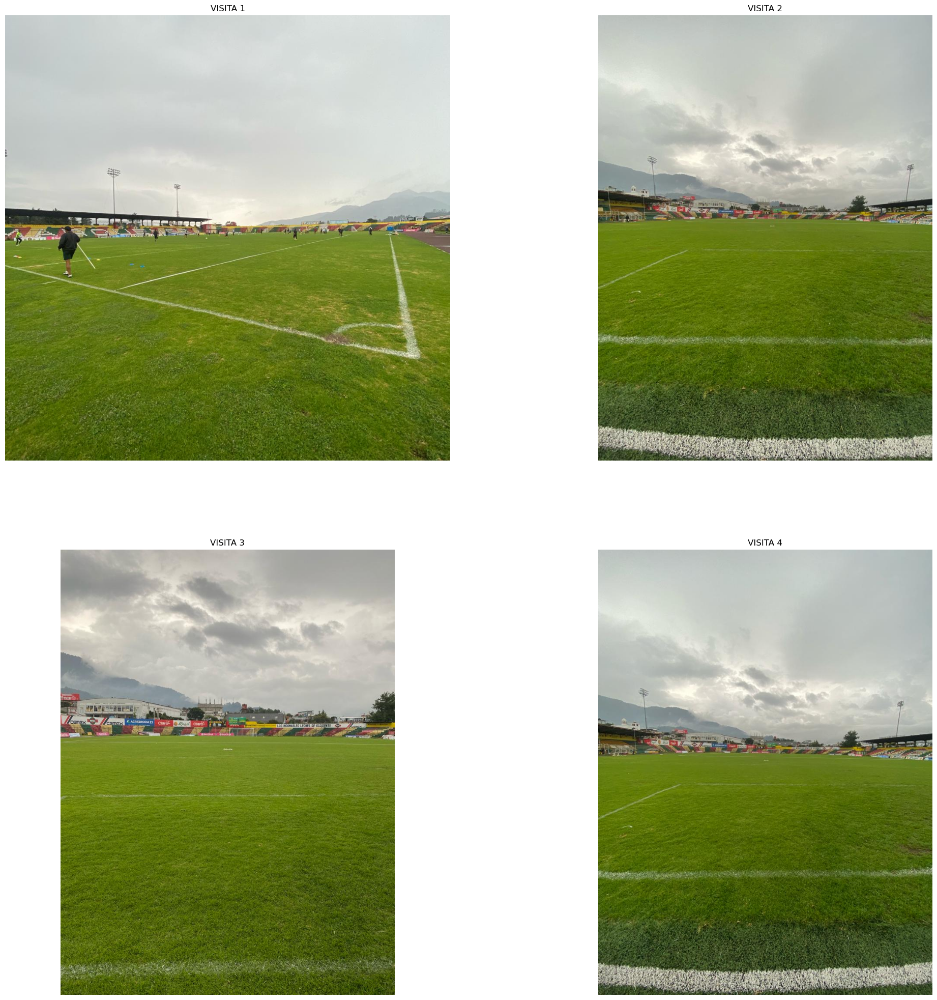

In [57]:
nombres_imagenes = ['visita1.jpg', 'visita2.jpg', 'visita3.jpg', 'visita4.jpg']
fig, axs = plt.subplots(2, 2)
fig.set_size_inches(25,25,25)
# fig.set_size_inches(30,50,30)
for i, nombre_imagen in enumerate(nombres_imagenes):
    fila = i // 2
    columna = i % 2
    img = cv2.imread(nombre_imagen)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[fila, columna].imshow(img)
    axs[fila, columna].set_title(f'VISITA {i + 1}')
    axs[fila, columna].axis('off')
plt.show()

### Metodología a utilizar

Se utilizaran las muestras de 4 imagenes del jardin, con una dimension de 30 x 30 y en base a esto se calculara el area del jardin

1. Se calculara el numero de tallos por una area de 30x30 cms. de las 4 imagenes.
2. Se realizara un promedio de las 4 imagenes para poner estimar el numero de tallos por un area de 30x30 cms.
3. Con los parametros obtendidos se calculara el area de un campo de futbol. aproximado.

In [37]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg

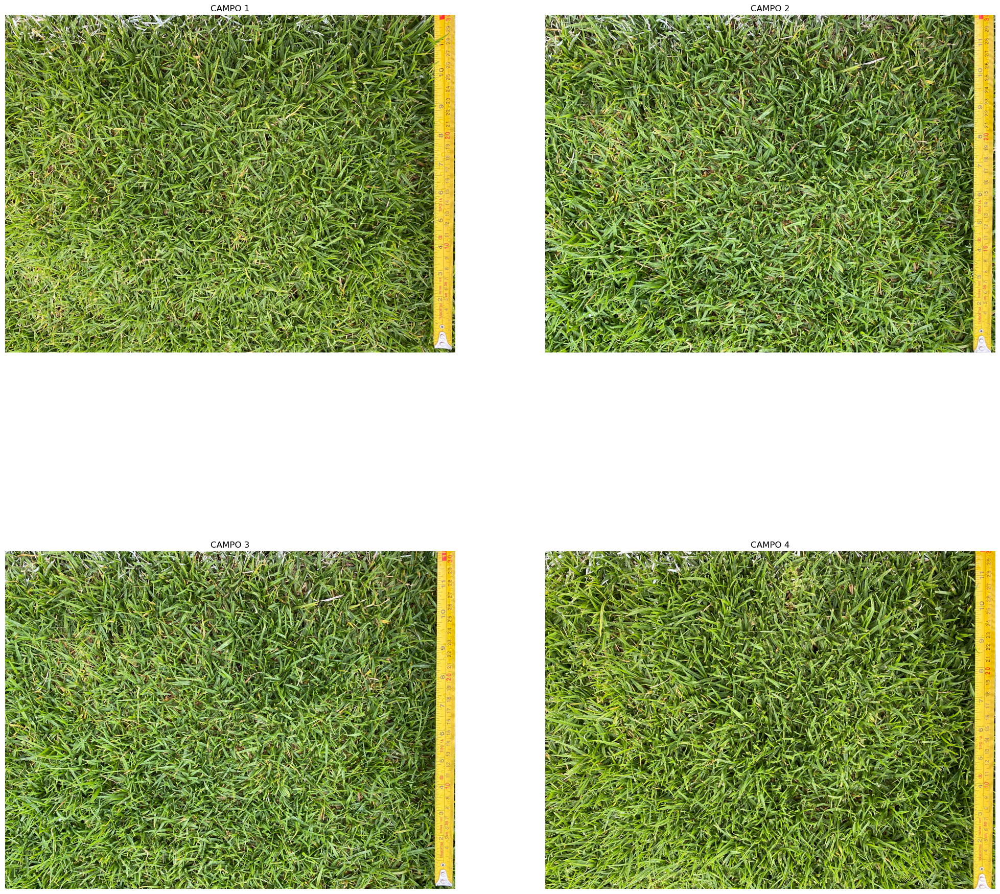

In [55]:
nombres_imagenes = ['campo1.jpg', 'campo2.jpg', 'campo3.jpg', 'campo4.jpg']
fig, axs = plt.subplots(2, 2)
fig.set_size_inches(25,25,25)
# fig.set_size_inches(30,50,30)
for i, nombre_imagen in enumerate(nombres_imagenes):
    fila = i // 2
    columna = i % 2
    img = cv2.imread(nombre_imagen)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[fila, columna].imshow(img)
    axs[fila, columna].set_title(f'CAMPO {i + 1}')
    axs[fila, columna].axis('off')
plt.show()

### Función de Procesamiento de transformacion y conteo de tallos

In [39]:
#Definiendo la función para cargar, filtrar, encontrar contornos y graficar contornos en la imagen original
def TransformarImagen(grama):
    imagenIn = cv2.imread(grama)
    gray_image = cv2.cvtColor(imagenIn, cv2.COLOR_BGR2GRAY)
    gaussiana = cv2.GaussianBlur(gray_image, (5, 5), 0)
    canny = cv2.Canny(gaussiana, 50, 150)
    contornos, hierarchy = cv2.findContours(canny, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    prueba = cv2.drawContours(imagenIn, contornos, -1, (0, 255, 0), 2)
    fig, axs = plt.subplots(2,2)
    fig.set_size_inches(25,25,25)
    nombres_imagenes = ['Imagen en escala de grises', 'Suavizado de la imagen', 'Contornos Imagen', 'Contornos']
    imagenes = [gray_image, gaussiana, canny, prueba]
    for i, nombre_imagen in enumerate(nombres_imagenes):
        fila = i // 2
        columna = i % 2        
        axs[fila, columna].imshow(imagenes[i])
        axs[fila, columna].set_title(f'{nombres_imagenes[i]}')
        axs[fila, columna].axis('off')
    plt.show()
    
    num = len(contornos)
    print("Se han detectado: {} tallos".format(num))
    return num

## Procesamiento de imagenes

### Calculo de tallos de imagen 1

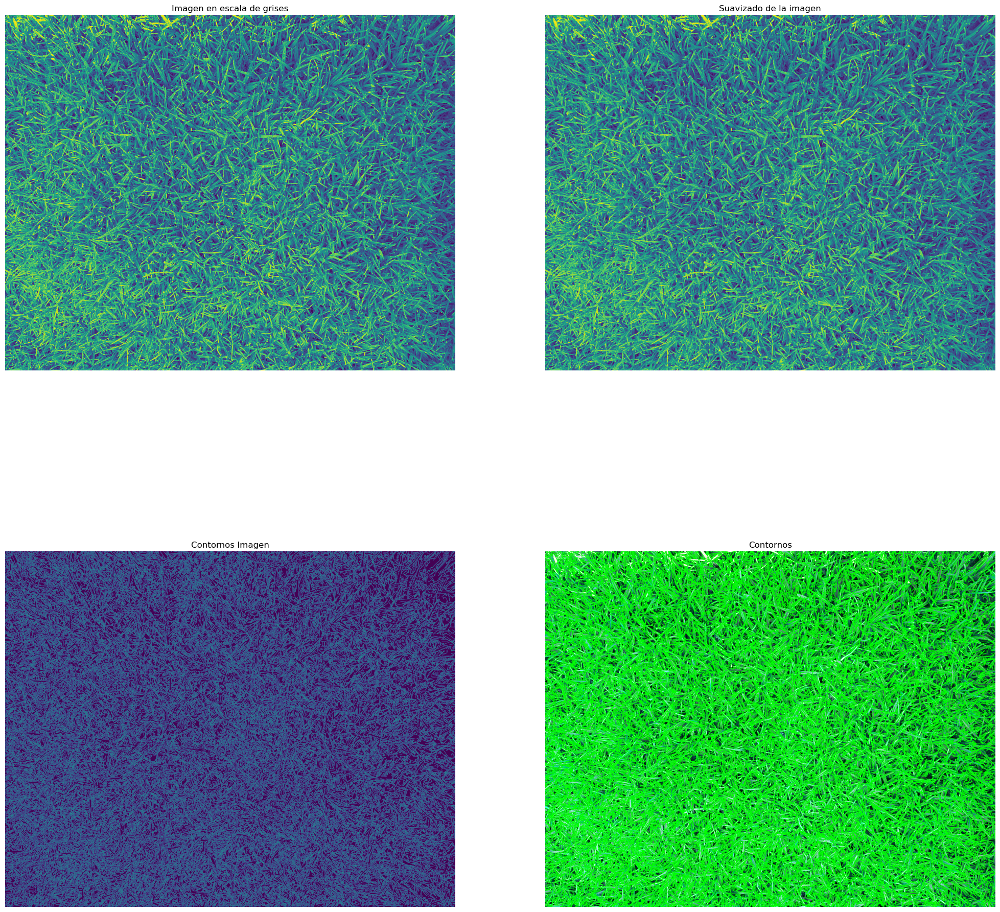

Se han detectado: 34889 tallos


In [43]:
campo1 = TransformarImagen('campo1SinRegla.jpg')

### Calculo de tallos de imagen 2

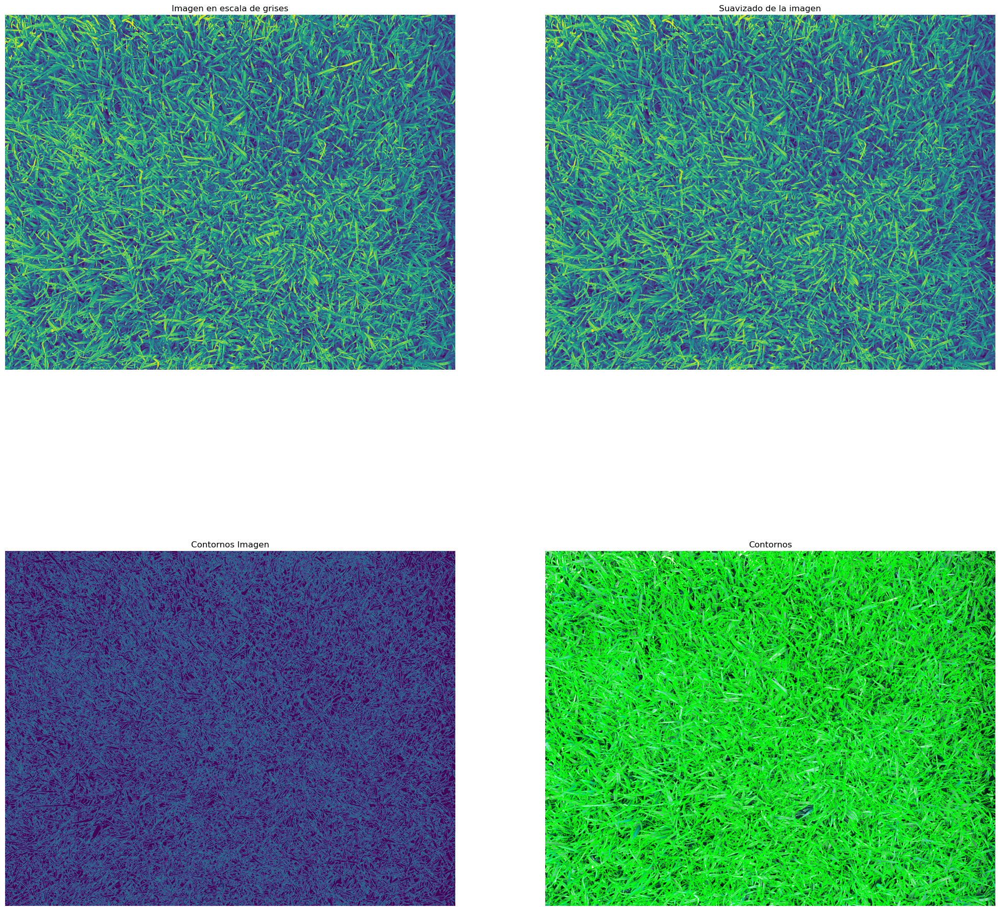

Se han detectado: 35615 tallos


In [42]:
campo2 = TransformarImagen('campo2SinRegla.jpg')

### Calculo de tallos de imagen 3

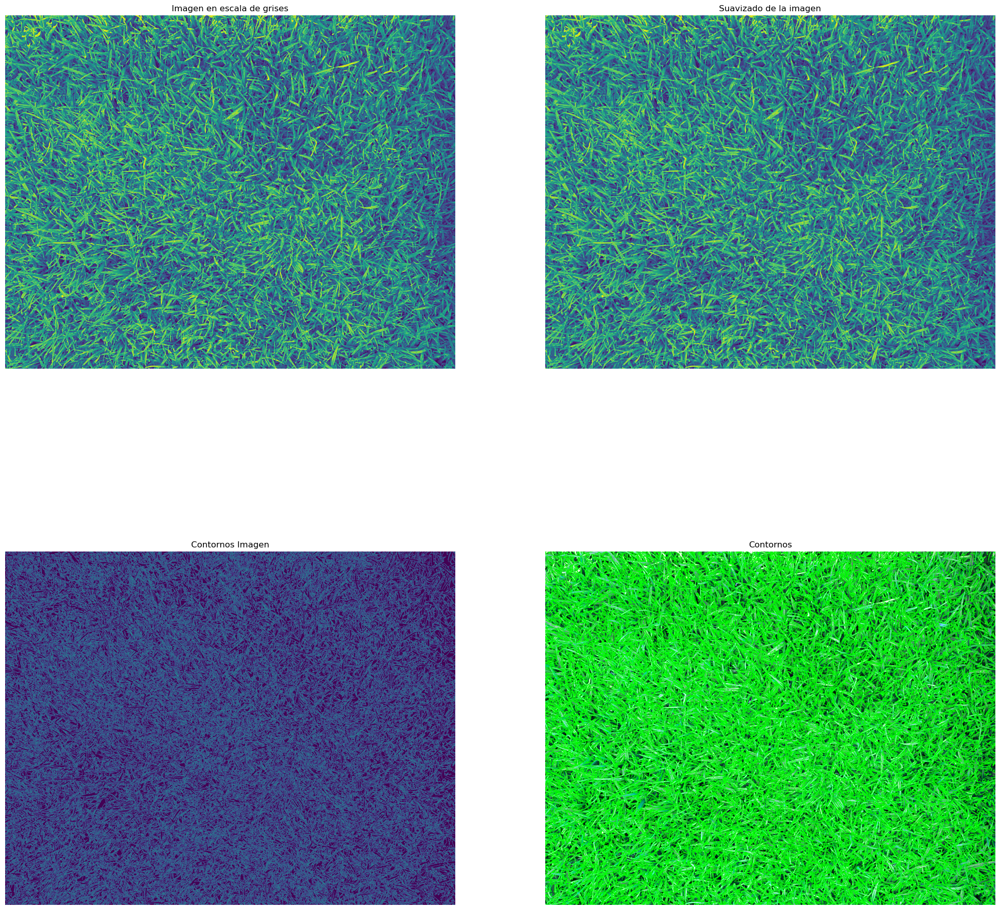

Se han detectado: 37392 tallos


In [44]:
campo3 = TransformarImagen('campo3SinRegla.jpg')

### Calculo de tallos de imagen 4

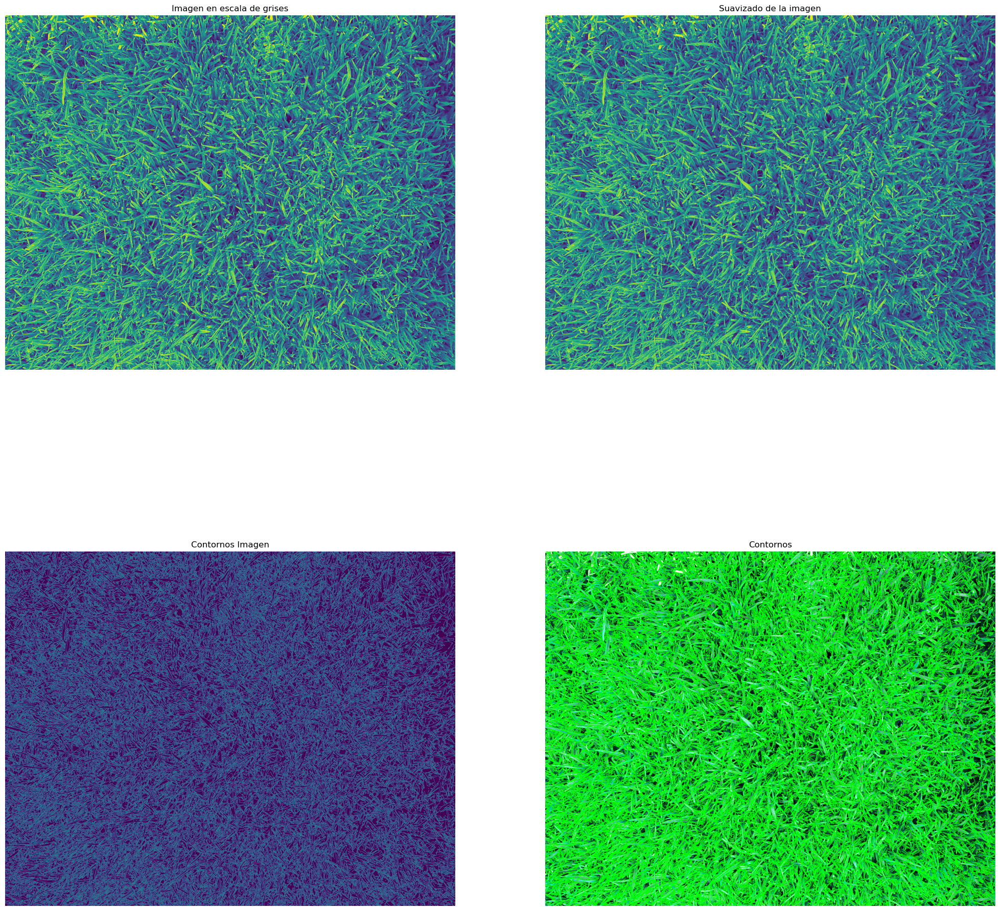

Se han detectado: 33137 tallos


In [45]:
campo4 = TransformarImagen('campo4SinRegla.jpg')

### Calculo de tallos por un area de 30 x 30 cms, promediando las 4 imagenes procesadas

In [46]:
promedio = (campo1 + campo2 + campo3 + campo4) / 4
print("El estimado de tallos por un area de 30x30 cms es: {} tallos".format(promedio))


El estimado de tallos por un area de 30x30 cms es: 35258.25 tallos


### Calculo de Tallos por el area de 30x30 cms en Metros cuadrados

Se Calcula la densidad de tallos por metro cuadrado en el área de 30x30 cm:

Área en metros cuadrados: (30 cm / 100) * (30 cm / 100) = 0.09 metros cuadrados

Densidad de tallos por metro cuadrado = 35258.25 tallos / 0.09 metros cuadrados = 391,647.33 tallos por metro cuadrado (aproximadamente)

In [52]:
mts = (30/100) * (30/100)
mts2 = promedio / mts
print("El estimado de tallos por un area de 30x30 por metro cuadrado es de: {} tallos".format(mts2))

El estimado de tallos por un area de 30x30 por metro cuadrado es de: 391758.3333333334 tallos


### Calculo metros cuadrados del estadio

Calcula el área total en metros cuadrados en el área más grande de 50 metros por 100 metros:

Área total = 50 metros * 100 metros = 5000 metros cuadrados

In [53]:
areaEstadio = 50 * 100
areaEstadio

5000

### Calculo del Area Total

Tallos totales = 5000 metros cuadrados * 391,647.22 tallos por metro cuadrado ≈ 1,958,791,666 tallos

In [54]:
areaTotalTallos = areaEstadio * mts2
print("El estimado de tallos por un area de 50 x 100 metro cuadrados es de: {} tallos".format(areaTotalTallos))

El estimado de tallos por un area de 50 x 100 metro cuadrados es de: 1958791666.6666667 tallos
